Julián David Quintero Medina, 20191177171

Daniel Enrique Perdomo Carvajal, 20192183270


El objetivo de este trabajo es desarrollar un modelo predictivo que utilice datos de cardiotocografía (CTG) y metadatos para evaluar el bienestar físico de los recién nacidos. Para lograrlo, se dispone de un conjunto de datos que incluye grabaciones de señales CTG intraparto y datos tabulares de las características de las madres y los bebés.

In [34]:
import pandas as pd
# Cargar datos tabulares
train_data = pd.read_csv(r"C:\Users\Sin nombre\Documents\DSP\processed_train\5439.csv")

# Eliminar las columnas 'seconds' y 'uc'
train_data_cleaned = train_data.drop(columns=['seconds', 'UC'])

# Extraer la columna 'FHR'
fhr_column = train_data_cleaned['FHR']

# Guardar los datos limpios en un archivo Excel
train_data_cleaned.to_excel("train_data_cleaned.xlsx", index=False)

print("Datos limpios guardados en train_data_cleaned.xlsx")

# Mostrar los valores de la columna 'FHR' junto con sus respectivas filas
print(fhr_column)



Datos limpios guardados en train_data_cleaned.xlsx
0        153.75
1        153.75
2        152.25
3        152.25
4        150.75
          ...  
10795     75.00
10796     74.75
10797     74.75
10798     74.75
10799     74.75
Name: FHR, Length: 10800, dtype: float64


In [33]:
import pandas as pd

# Cargar datos limpios desde el archivo Excel
train_data_cleaned = pd.read_excel("train_data_cleaned.xlsx")

# Normalizar los datos según la condición especificada
def custom_normalization(value):
    if 110 <= value <= 160:
        return 0
    else:
        return 1

# Aplicar la normalización a la columna 'FHR'
train_data_cleaned['FHR_normalized'] = train_data_cleaned['FHR'].apply(custom_normalization)

# Guardar los datos normalizados en un nuevo archivo Excel
train_data_cleaned.to_excel("train_data_normalized.xlsx", index=False)

print("Datos normalizados guardados en train_data_normalized.xlsx")




Datos normalizados guardados en train_data_normalized.xlsx


In [10]:
import os
import pandas as pd

# Ruta al directorio donde están los archivos CSV de entrenamiento
train_input_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\train'

# Ruta al directorio donde están los archivos CSV de prueba
test_input_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\test'

# Directorio de salida para los archivos procesados de entrenamiento
train_output_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\processed_train_data'

# Directorio de salida para los archivos procesados de prueba
test_output_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\processed_test_data'

# Crear el directorio de salida para los archivos de entrenamiento si no existe
os.makedirs(train_output_dir, exist_ok=True)

# Crear el directorio de salida para los archivos de prueba si no existe
os.makedirs(test_output_dir, exist_ok=True)

# Procesar los archivos de entrenamiento
train_files = [f for f in os.listdir(train_input_dir) if f.endswith('.csv')]
for file in train_files:
    file_path = os.path.join(train_input_dir, file)
    data = pd.read_csv(file_path)

    # Tomar los últimos 12600 valores
    data_subset = data.tail(12600)

    # Guardar el subconjunto en un nuevo archivo en el directorio de salida para entrenamiento
    output_file_path = os.path.join(train_output_dir, file)
    data_subset.to_csv(output_file_path, index=False)

print("Procesamiento de entrenamiento completado.")

# Procesar los archivos de prueba
test_files = [f for f in os.listdir(test_input_dir) if f.endswith('.csv')]
for file in test_files:
    file_path = os.path.join(test_input_dir, file)
    data = pd.read_csv(file_path)

    # Tomar los últimos 12600 valores
    data_subset = data.tail(12600)

    # Guardar el subconjunto en un nuevo archivo en el directorio de salida para prueba
    output_file_path = os.path.join(test_output_dir, file)
    data_subset.to_csv(output_file_path, index=False)

print("Procesamiento de prueba completado.")



Procesamiento de entrenamiento completado.
Procesamiento de prueba completado.


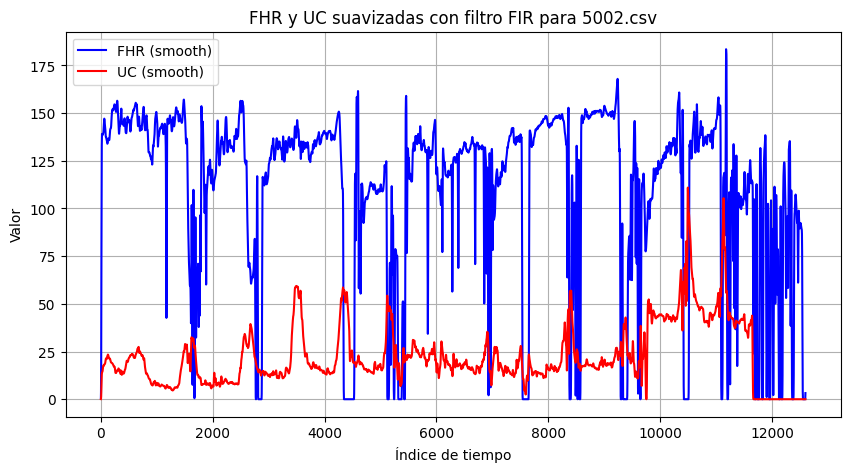

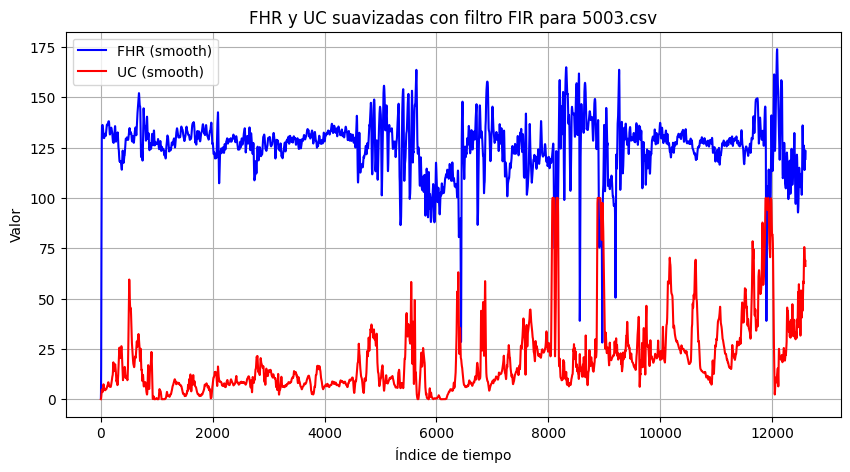

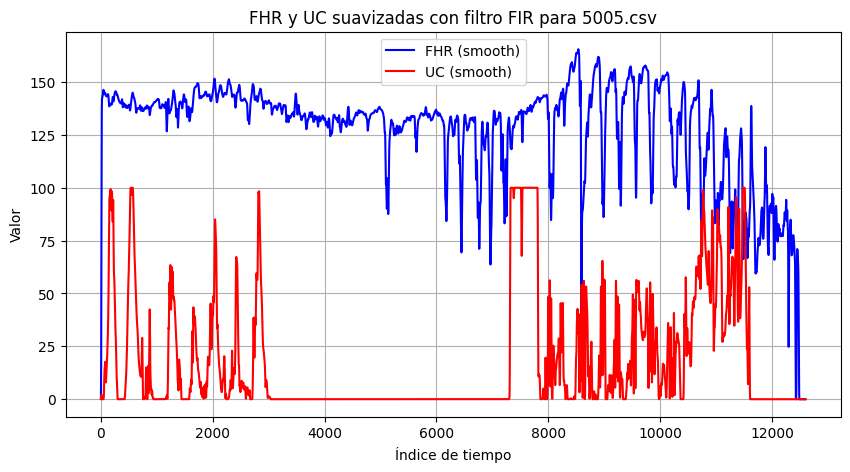

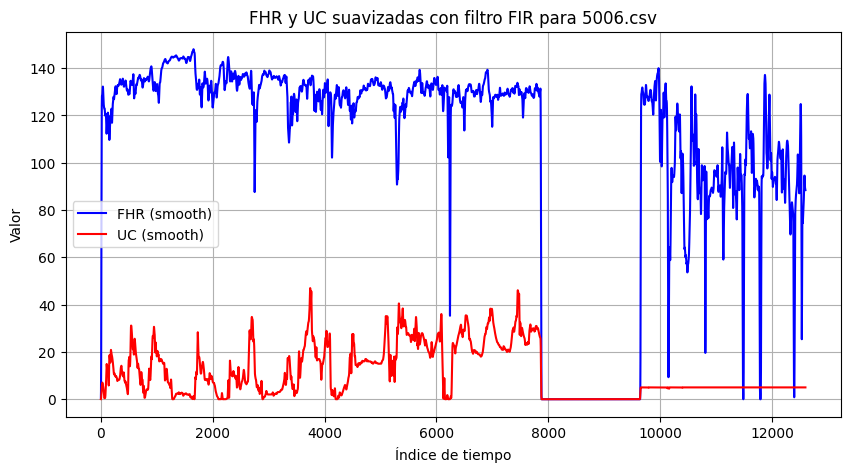

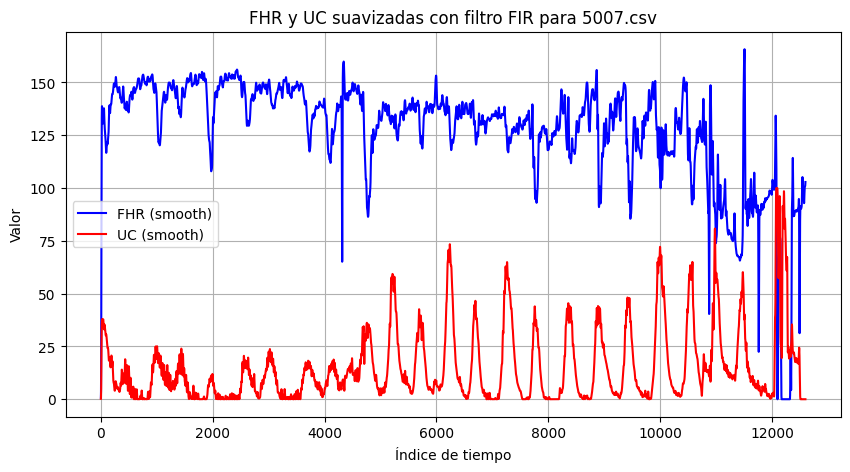

...

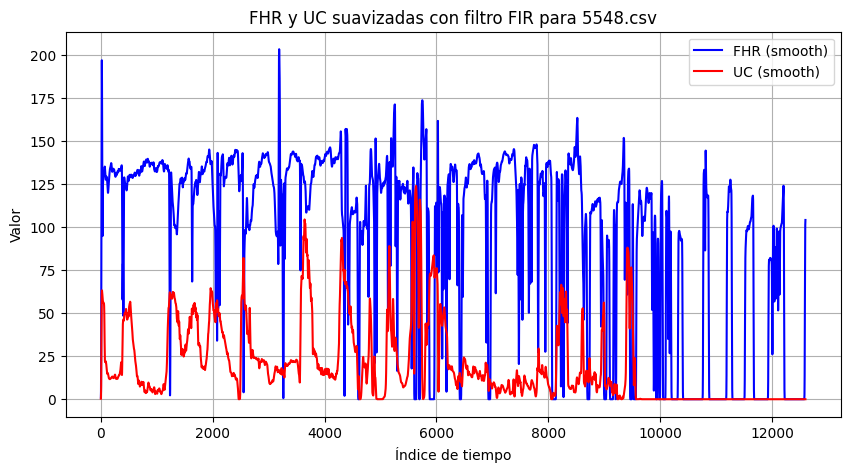

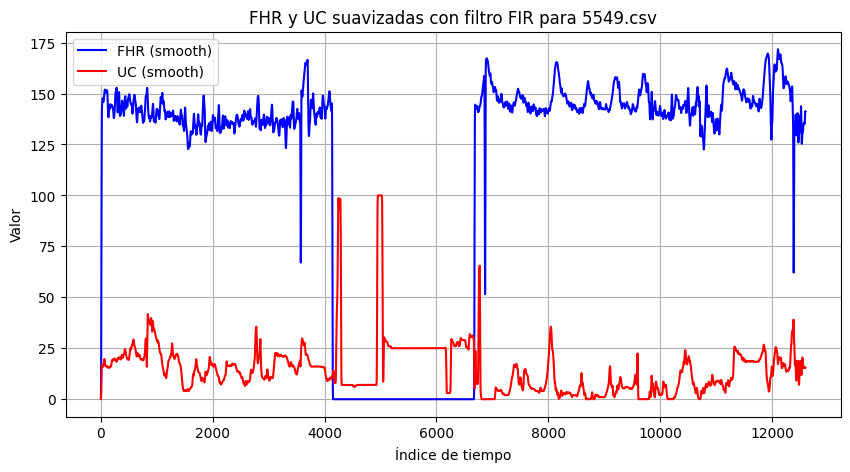

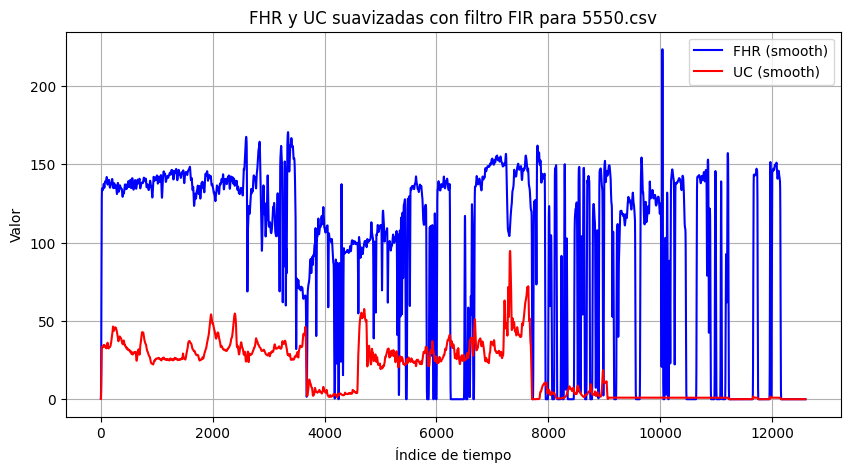

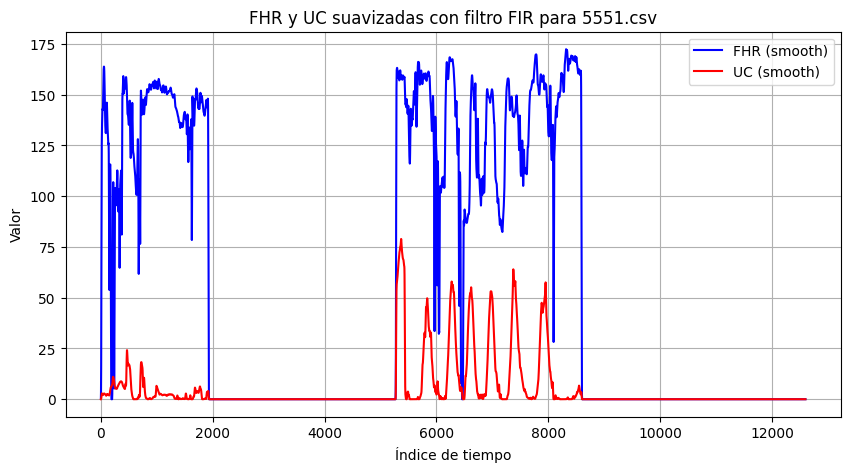

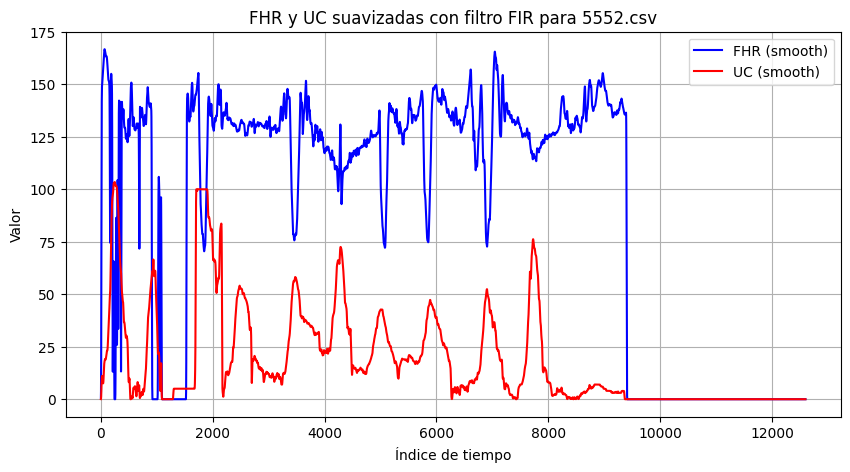

In [44]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import firwin, lfilter

# Directorio donde se encuentran los archivos procesados
processed_dir = r'C:\Users\Sin nombre\Documents\DSP\processed_data'

# Obtener la lista de archivos CSV en el directorio de entrada
files = [f for f in os.listdir(processed_dir) if f.endswith('.csv')]

# Parámetros del filtro FIR
numtaps = 21  # Número de coeficientes del filtro FIR
cutoff_freq = 0.05  # Frecuencia de corte relativa (0.5 es la mitad de la frecuencia de muestreo)

# Diseñar el filtro FIR
b = firwin(numtaps, cutoff_freq)

# Graficar las columnas FHR y UC de cada archivo CSV con filtro FIR
for file in files:
    file_path = os.path.join(processed_dir, file)
    data = pd.read_csv(file_path)

    # Aplicar el filtro FIR a la columna FHR
    data['FHR_smooth'] = lfilter(b, 1, data['FHR'])
    # Aplicar el filtro FIR a la columna UC
    data['UC_smooth'] = lfilter(b, 1, data['UC'])

    plt.figure(figsize=(10, 5))
    plt.plot(data['FHR_smooth'], label='FHR (smooth)', color='blue')
    plt.plot(data['UC_smooth'], label='UC (smooth)', color='red')
    plt.title(f'FHR y UC suavizadas con filtro FIR para {file}')
    plt.xlabel('Índice de tiempo')
    plt.ylabel('Valor')
    plt.legend()
    plt.grid(True)
    plt.show()


In [11]:
import os
import pandas as pd

# Directorio donde se encuentran los archivos procesados de entrenamiento
train_processed_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\processed_train_data'

# Directorio donde se encuentran los archivos procesados de prueba
test_processed_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\processed_test_data'

# Directorio para los archivos normalizados de entrenamiento
train_output_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train'

# Directorio para los archivos normalizados de prueba
test_output_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_test'

# Crear el directorio de salida para los archivos normalizados de entrenamiento si no existe
os.makedirs(train_output_dir, exist_ok=True)

# Crear el directorio de salida para los archivos normalizados de prueba si no existe
os.makedirs(test_output_dir, exist_ok=True)

# Procesar los archivos de entrenamiento
train_files = [f for f in os.listdir(train_processed_dir) if f.endswith('.csv')]
for file in train_files:
    file_path = os.path.join(train_processed_dir, file)
    data = pd.read_csv(file_path)

    # Normalizar los datos de la columna 'FHR' según la condición especificada
    def custom_normalization(value):
        if 110 <= value <= 160:
            return 0
        else:
            return 1

    # Aplicar la normalización a la columna 'FHR'
    data['FHR_normalized'] = data['FHR'].apply(custom_normalization)

    # Crear un nuevo DataFrame con la columna 'FHR_normalized' solamente
    normalized_data = data[['FHR_normalized']]

    # Guardar los datos normalizados en un nuevo archivo CSV en la carpeta de entrenamiento
    output_file_path = os.path.join(train_output_dir, f"{file.split('.')[0]}_normalized_FHR.csv")
    normalized_data.to_csv(output_file_path, index=False)
    print(f"Datos normalizados de FHR de entrenamiento guardados en {output_file_path}")

# Procesar los archivos de prueba
test_files = [f for f in os.listdir(test_processed_dir) if f.endswith('.csv')]
for file in test_files:
    file_path = os.path.join(test_processed_dir, file)
    data = pd.read_csv(file_path)

    # Normalizar los datos de la columna 'FHR' según la condición especificada
    def custom_normalization(value):
        if 110 <= value <= 160:
            return 0
        else:
            return 1

    # Aplicar la normalización a la columna 'FHR'
    data['FHR_normalized'] = data['FHR'].apply(custom_normalization)

    # Crear un nuevo DataFrame con la columna 'FHR_normalized' solamente
    normalized_data = data[['FHR_normalized']]

    # Guardar los datos normalizados en un nuevo archivo CSV en la carpeta de prueba
    output_file_path = os.path.join(test_output_dir, f"{file.split('.')[0]}_normalized_FHR.csv")
    normalized_data.to_csv(output_file_path, index=False)
    print(f"Datos normalizados de FHR de prueba guardados en {output_file_path}")


Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5002_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5003_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5005_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5006_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5007_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train\5008_normalized_FHR.csv
Datos normalizados de FHR de entrenamiento guardados

In [13]:
import os
import pandas as pd

# Directorio donde se encuentran los archivos normalizados de entrenamiento
train_normalized_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_train'

# Directorio donde se encuentran los archivos normalizados de prueba
test_normalized_dir = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\normalizado_test'

# Obtener la lista de archivos CSV normalizados de entrenamiento
train_files = [f for f in os.listdir(train_normalized_dir) if f.endswith('.csv')]

# Obtener la lista de archivos CSV normalizados de prueba
test_files = [f for f in os.listdir(test_normalized_dir) if f.endswith('.csv')]

# Lista para almacenar los resultados de entrenamiento y prueba respectivamente
train_results = []
test_results = []

# Iterar sobre cada archivo normalizado de entrenamiento
for file in train_files:
    file_path = os.path.join(train_normalized_dir, file)
    data = pd.read_csv(file_path)

    # Calcular el porcentaje de ceros en la columna 'FHR_normalized'
    zero_percentage = (data['FHR_normalized'] == 0).mean() * 100

    # Determinar el valor a guardar en el archivo general
    result_value = 0 if zero_percentage >= 60 else 1

    # Obtener el número de registro del archivo
    record_id = file.split('_')[0]

    # Agregar el resultado a la lista de entrenamiento
    train_results.append({'Value': result_value, 'File': record_id})

# Iterar sobre cada archivo normalizado de prueba
for file in test_files:
    file_path = os.path.join(test_normalized_dir, file)
    data = pd.read_csv(file_path)

    # Calcular el porcentaje de ceros en la columna 'FHR_normalized'
    zero_percentage = (data['FHR_normalized'] == 0).mean() * 100

    # Determinar el valor a guardar en el archivo general
    result_value = 0 if zero_percentage >= 60 else 1

    # Obtener el número de registro del archivo
    record_id = file.split('_')[0]

    # Agregar el resultado a la lista de prueba
    test_results.append({'Value': result_value, 'File': record_id})

# Crear DataFrames con los resultados de entrenamiento y prueba
train_results_df = pd.DataFrame(train_results)
test_results_df = pd.DataFrame(test_results)

# Guardar los resultados en archivos CSV separados para entrenamiento y prueba
train_output_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_train.csv'
test_output_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_test.csv'

train_results_df.to_csv(train_output_file_path, index=False)
test_results_df.to_csv(test_output_file_path, index=False)

print("Resultados de entrenamiento guardados en", train_output_file_path)
print("Resultados de prueba guardados en", test_output_file_path)


Resultados de entrenamiento guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_train.csv
Resultados de prueba guardados en C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_test.csv


In [14]:
import pandas as pd

# Directorio donde se encuentra el archivo 'train.csv'
input_train_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train.csv'

# Leer el archivo CSV de entrenamiento
df_train = pd.read_csv(input_train_file_path)

# Verificar los nombres de las columnas en el DataFrame de entrenamiento
print("Nombres de las columnas en el DataFrame de entrenamiento:", df_train.columns)

# Filtrar solo las columnas 'recordID' y 'babyhealth' para el DataFrame de entrenamiento
df_train_filtered = df_train[['recordID', 'babyhealth']]

# Convertir 'babyhealth' a cadena (str) y formatear los valores en el DataFrame de entrenamiento
df_train_filtered['babyhealth'] = df_train_filtered['babyhealth'].astype(str).map(lambda x: f"{x}.0" if "." not in str(x) else x)

# Verificar los tipos de datos después de la conversión para el DataFrame de entrenamiento
print("Tipos de datos después de la conversión para el DataFrame de entrenamiento:", df_train_filtered.dtypes)

# Ordenar el DataFrame de entrenamiento por la columna 'recordID' de manera creciente
df_train_sorted = df_train_filtered.sort_values(by='recordID', ascending=True)

# Directorio donde se guardará el archivo ordenado de entrenamiento
output_train_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train_sorted.csv'

# Guardar el DataFrame ordenado de entrenamiento en un nuevo archivo CSV
df_train_sorted.to_csv(output_train_file_path, index=False)

print(f"Archivo de entrenamiento ordenado guardado como '{output_train_file_path}'.")

# Directorio donde se encuentra el archivo 'test.csv'
input_test_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test.csv'

# Leer el archivo CSV de prueba
df_test = pd.read_csv(input_test_file_path)

# Verificar los nombres de las columnas en el DataFrame de prueba
print("Nombres de las columnas en el DataFrame de prueba:", df_test.columns)

# Filtrar solo la columna 'recordID' para el DataFrame de prueba
df_test_filtered = df_test[['recordID']]

# Directorio donde se guardará el archivo filtrado de prueba
output_test_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test_filtered.csv'

# Guardar el DataFrame filtrado de prueba en un nuevo archivo CSV
df_test_filtered.to_csv(output_test_file_path, index=False)

print(f"Archivo de prueba filtrado guardado como '{output_test_file_path}'.")


Nombres de las columnas en el DataFrame de entrenamiento: Index(['recordID', 'babyhealth', 'gestweeks', 'sex', 'age', 'gravidity',
       'parity', 'diabetes', 'hypertension', 'preeclampsia', 'pyrexia',
       'meconium', 'noprogress', 'rectype'],
      dtype='object')


C:\Users\julia\AppData\Local\Temp\ipykernel_11860\2479431114.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_filtered['babyhealth'] = df_train_filtered['babyhealth'].astype(str).map(lambda x: f"{x}.0" if "." not in str(x) else x)


Tipos de datos después de la conversión para el DataFrame de entrenamiento: recordID       int64
babyhealth    object
dtype: object
Archivo de entrenamiento ordenado guardado como 'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train_sorted.csv'.
Nombres de las columnas en el DataFrame de prueba: Index(['recordID', 'gestweeks', 'sex', 'age', 'gravidity', 'parity',
       'diabetes', 'hypertension', 'preeclampsia', 'pyrexia', 'meconium',
       'noprogress', 'rectype'],
      dtype='object')
Archivo de prueba filtrado guardado como 'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test_filtered.csv'.


In [22]:
import pandas as pd

# Directorio donde se encuentra el archivo 'train_sorted.csv'
input_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train_sorted.csv'

# Leer el archivo CSV
df_sorted = pd.read_csv(input_file_path)

# Directorio donde se encuentra el archivo 'resultados generales.csv'
resultados_generales_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_train.csv'

# Leer el archivo CSV de resultados generales
df_resultados = pd.read_csv(resultados_generales_path)

# Agregar una nueva columna 'Value' con los valores de los resultados generales
df_sorted['Value'] = df_resultados['Value']

# Directorio donde se guardará el archivo actualizado
output_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train_sorted_with_values.csv'

# Guardar el DataFrame actualizado en un nuevo archivo CSV
df_sorted.to_csv(output_file_path, index=False)

print(f"Archivo actualizado guardado como '{output_file_path}'.")


Archivo actualizado guardado como 'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\train_sorted_with_values.csv'.


In [26]:
import pandas as pd

# Directorio donde se encuentra el archivo 'test_filtered.csv'
input_test_filtered_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test_filtered.csv'

# Leer el archivo CSV de prueba filtrado
df_test_filtered = pd.read_csv(input_test_filtered_path)

# Directorio donde se encuentra el archivo 'resultados_generales_test.csv'
resultados_generales_test_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\signals\resultados_generales_test.csv'

# Leer el archivo CSV de resultados generales para prueba
df_resultados_test = pd.read_csv(resultados_generales_test_path)

# Agregar una nueva columna 'Value' con los valores de los resultados generales para prueba
df_test_filtered['Value'] = df_resultados_test['Value']

# Convertir 'Value' a cadena (str) y formatear los valores
df_test_filtered['Value'] = df_test_filtered['Value'].astype(str).map(lambda x: f"{x}.0" if "." not in str(x) else x)

# Directorio donde se guardará el archivo de prueba actualizado
output_test_file_path = r'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test_filtered_with_values.csv'

# Guardar el DataFrame de prueba actualizado en un nuevo archivo CSV
df_test_filtered.to_csv(output_test_file_path, index=False)

print(f"Archivo de prueba actualizado guardado como '{output_test_file_path}'.")


Archivo de prueba actualizado guardado como 'C:\Users\julia\Documents\DSP\DSP_El_Bueno\data\data\test_filtered_with_values.csv'.
